# Anomaly detection on Transmission links (throughput time series)

### Content:
1. Connect to link database and and get familiar with the data (an example sql db in data folder)
   - MW links
   - Routers
   
   
2. Anomaly Detection, CUSUM
   - MW links
   - Routers
   
   
3. Anomaly Detection, unsupervised machine learning
   - MW links
   - Routers
   
   
4. Anomaly Detection, Auto Correlation with thresholds
   - MW links
   - Routers
   
   

### Tools/ frameworks used:
- Python 3
    - Pandas (data analysis and manipulation tool)
    - SQLite (to store link data in sql db)
    - Plotly (for plotting/ visualization)
    - Matplotlib (for plotting/ visualization)
    - Kats (open source from Facebook research for time series forecasting and anomaly detection)
        https://engineering.fb.com/2021/06/21/open-source/kats/
    - PyCaret (open-source, low-code machine learning library and end-to-end model management tool)
        https://pycaret.org/,
        https://github.com/pycaret/pycaret

By Glenn Landgren
- https://www.linkedin.com/in/glenn-landgren/
- https://github.com/Phytys
- https://transmissionvision.com/

In [1]:
# Requirements
from datetime import datetime, timedelta, time, date
import datetime
import numpy as np
import pandas as pd
import sqlite3
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

# --> Doing import of kats in cahapter 2
# from kats.consts import TimeSeriesData
# from kats.detectors.cusum_detection import CUSUMDetector

# --> Doing import of pycaret in chapter 3
# from pycaret.anomaly import *


# 1. Connect to sql database

## 1a) Connect to mw-link sql database and and get familiar with the data

In [2]:

def check_mw_db():
    """
    Checking columns, number of unique node Ids in db
    and first/ last timestamps in db
    """
    
    # Make connection to sql database
    con = sqlite3.connect("data/mw_nodes.db")

    df1 = pd.read_sql("""
    SELECT *
    FROM mw_nodes
    GROUP BY node_id
    """, con)
    df2 = pd.read_sql("""
    SELECT timestamp
    FROM mw_nodes
    GROUP BY timestamp
    """, con)
    
    unique_nodes = list(df1.node_id.unique())
    start_date = list(df2.iloc[0])
    end_date   = list(df2.iloc[-1])
    
    print("Columns in database: ", list(df1.columns))
    #print("Unique node_id:", unique_nodes)
    print("First and last timestamp in db", start_date, end_date)
    
    return unique_nodes, df1.head(3)

check_mw_db()

Columns in database:  ['timestamp', 'node_id', 'average_throughput', 'peak_throughput']
First and last timestamp in db ['2020-09-02 15:15:00'] ['2021-08-03 00:00:00']


(['MW_1',
  'MW_10',
  'MW_11',
  'MW_12',
  'MW_13',
  'MW_14',
  'MW_15',
  'MW_16',
  'MW_17',
  'MW_18',
  'MW_19',
  'MW_2',
  'MW_20',
  'MW_21',
  'MW_22',
  'MW_3',
  'MW_4',
  'MW_5',
  'MW_6',
  'MW_7',
  'MW_8',
  'MW_9'],
              timestamp node_id  average_throughput  peak_throughput
 0  2020-09-02 17:15:00    MW_1            24078076        136293264
 1  2020-09-02 17:15:00   MW_10           176998853        282408768
 2  2020-09-02 17:15:00   MW_11           242298980        399302984)

In [3]:

def get_mw_node(node, n_days, resolution, agg_all_nodes=False):
    """
    This function fetch data from MW sql db for a specific 'node' over selected days ('n_days')
    and returns a pandas dataframe.
    - n_days:  days back in time to select data for
    - resolution: resolution can be 'day', 'hour' or '15min' (original resolution is 15min)
    - agg_all_nodes: if 'agg_all_nodes' is set to True, the data for all nodes is aggregated
      so you will see throughput data for all nodes combined/ aggregated
    """
    # IMPORTANT NOTE Below we use the last date in db, minus days selected
    # in real life we would use todays date (instead of 2021-08-03 00:00:00)
    start_date = date.fromisoformat("2021-08-03") - timedelta(days = n_days)
    
    con = sqlite3.connect("data/mw_nodes.db")
    
    if not agg_all_nodes:
        df = pd.read_sql("""
        SELECT *
        FROM mw_nodes
        WHERE node_id = ?
        AND timestamp > ?
        """, con, params=[node, start_date])
        
    elif agg_all_nodes:
        df = pd.read_sql("""
        SELECT *
        FROM mw_nodes
        WHERE timestamp > ?
        """, con, params=[start_date])

    df.timestamp=pd.to_datetime(df.timestamp)
    
    if resolution == "15min":
        df.timestamp = df.timestamp
        
        if agg_all_nodes:
            df = df.groupby("timestamp").agg(
                average_throughput  = pd.NamedAgg(column="average_throughput", aggfunc="mean"),
                peak_throughput     = pd.NamedAgg(column="peak_throughput", aggfunc="max"),
                node_id             = pd.NamedAgg(column="node_id", aggfunc="last")
            )   
        df = df.round(0)
            
    elif resolution == "hour":
        df.timestamp = df.timestamp.dt.floor("H")
        
        df = df.groupby("timestamp").agg(
            average_throughput      = pd.NamedAgg(column="average_throughput", aggfunc="mean"),
            peak_throughput         = pd.NamedAgg(column="peak_throughput", aggfunc="max"),
            node_id                 = pd.NamedAgg(column="node_id", aggfunc="last")
            )
        df = df.round(0)
        
    elif resolution == "day":
        df.timestamp = df.timestamp.dt.floor("D")
        
        df = df.groupby("timestamp").agg(
            average_throughput           = pd.NamedAgg(column="average_throughput", aggfunc="mean"),
            average_throughput_busy_hour = pd.NamedAgg(column="average_throughput", aggfunc="max"),
            peak_throughput              = pd.NamedAgg(column="peak_throughput", aggfunc="max"),
            node_id                      = pd.NamedAgg(column="node_id", aggfunc="last")
            )
        df = df.round(0)
        # NOTE
        # When aggregating on day, drop last day since data will not be accurate
        df.drop(df.tail(1).index,inplace=True)
        
    else:
        return "Resolution mest be '15min', 'hour', or 'day'"
    
    if agg_all_nodes:
        df.drop("node_id", axis=1, inplace=True)
        
    df.reset_index(inplace=True)
    
    return df


In [4]:
# Test function and see what the dataframe looks like
get_mw_node("MW_1", 300, "day", agg_all_nodes=False)

,timestamp,average_throughput,average_throughput_busy_hour,peak_throughput,node_id
0,2020-10-07,21319279.0,45000705,221990064,MW_1
1,2020-10-08,22461404.0,67914111,204069016,MW_1
2,2020-10-09,24551578.0,89673235,226078848,MW_1
3,2020-10-10,23558814.0,43146455,193313312,MW_1
4,2020-10-11,23582483.0,53638592,206944216,MW_1
...,...,...,...,...,...
295,2021-07-29,101983904.0,222165212,308401840,MW_1
296,2021-07-30,105317568.0,189583550,308138312,MW_1
297,2021-07-31,113609508.0,204043941,293954344,MW_1
298,2021-08-01,109605446.0,209125251,306738832,MW_1


In [5]:
def plot_mw(node, n_days, resolution, agg_all_nodes=False):
    """
    This function return interactive plot with throughput data for a specific node over selected days
    Resolution can be day, hour or 15min (original resolution from db is 15min)
    """
    # call func to get data from sql db
    df = get_mw_node(node, n_days, resolution, agg_all_nodes)
    df.set_index("timestamp", inplace=True)
    try:
        # Create figure with secondary y-axis
        fig = make_subplots(specs=[[{"secondary_y": True}]])
        # Add traces
        fig.add_trace(
            go.Scatter(x=df.index, y=df["average_throughput"], name="avg_throughput"),
            secondary_y=False,
        )
        fig.add_trace(
            go.Scatter(x=df.index, y=df["peak_throughput"], name="peak_throughput"),
            secondary_y=False,
        )
        if resolution == "day":
            fig.add_trace(
                go.Scatter(x=df.index, y=df["average_throughput_busy_hour"], name="average_busy_hour"),
                secondary_y=False,
            )
        # Add figure title
        fig.update_layout(
            title_text=f"Node id is: {node if not agg_all_nodes else 'All nodes'}, Resolution is: {resolution}"
        )
        # Set y-axes titles
        fig.update_yaxes(title_text="<b>** Throughput **</b>", secondary_y=False, color="black")
        fig.update_yaxes(title_text="<b>** xxx **</b>", secondary_y=True, color="purple")

        fig.show()
        
    except:
        print("Error - Check resolution input requirements")
    
    return df.shape

In [6]:
plot_mw("MW_1", 14, "hour", agg_all_nodes=False)

(337, 3)

## 1b) Connect to router sql database and and get familiar with the data

In [7]:
def check_router_db():
    """
    Checking columns, number of unique node Ids in db
    and first/ last timestamps in db
    """
    
    # Make connection to sql database
    con = sqlite3.connect("data/routers.db")

    df1 = pd.read_sql("""
    SELECT *
    FROM routers
    GROUP BY router_id
    """, con)
    df2 = pd.read_sql("""
    SELECT timestamp
    FROM routers
    GROUP BY timestamp
    """, con)
    
    unique_nodes = list(df1.router_id.unique())
    start_date = list(df2.iloc[0])
    end_date   = list(df2.iloc[-1])
    
    print("Columns in database: ", list(df1.columns))
    #print("Unique node_id:", unique_nodes)
    print("First and last timestamp in db", start_date, end_date)
    
    return unique_nodes, df1.head(3)

check_router_db()

Columns in database:  ['timestamp', 'router_id', 'port_speed', 'if', 'in_Mbps', 'out_Mbps']
First and last timestamp in db ['2021-02-04 08:45:00'] ['2021-08-03 08:15:00']


(['ROUTER_1',
  'ROUTER_10',
  'ROUTER_11',
  'ROUTER_2',
  'ROUTER_3',
  'ROUTER_4',
  'ROUTER_5',
  'ROUTER_6',
  'ROUTER_7',
  'ROUTER_8',
  'ROUTER_9'],
              timestamp  router_id   port_speed    if      in_Mbps     out_Mbps
 0  2021-02-04 10:00:00   ROUTER_1  100000000.0  2/37   820.189489     1.197711
 1  2021-02-04 10:00:00  ROUTER_10  100000000.0  1/33  9827.998521  1443.508121
 2  2021-05-19 14:00:00  ROUTER_11  100000000.0  2/37     0.000000     0.000000)

In [8]:

def get_router_node(node, n_days, resolution, agg_all_nodes=False):
    """
    This function fetch data from Router sql db for a specific 'node' over selected days ('n_days')
    and returns a pandas dataframe
    - n_days: days back in time to select data for
    - resolution: resolution can be 'day', 'hour' or '15min' (original resolution is 15min)
    - agg_all_nodes: if 'agg_all_nodes' is set to True, the data for all nodes is aggregated
      so you will see throughput data for all nodes combined/ aggregated
    """
    # IMPORTANT NOTE Below we use the last date in db, minus days selected
    # in real life we would use todays date (instead of 2021-08-03 00:00:00)
    start_date = date.fromisoformat("2021-08-03") - timedelta(days = n_days)
    
    con = sqlite3.connect("data/routers.db")
    
    if not agg_all_nodes:
        df = pd.read_sql("""
        SELECT *
        FROM routers
        WHERE router_id = ?
        AND timestamp > ?
        """, con, params=[node, start_date])
        
    elif agg_all_nodes:
        df = pd.read_sql("""
        SELECT *
        FROM routers
        WHERE timestamp > ?
        """, con, params=[start_date])

    df.timestamp=pd.to_datetime(df.timestamp)
    
    if resolution == "15min":
        df.timestamp = df.timestamp
        
        if agg_all_nodes:
            df = df.groupby("timestamp").agg(
                in_Mbps  = pd.NamedAgg(column="in_Mbps", aggfunc="mean"),
                out_Mbps = pd.NamedAgg(column="out_Mbps", aggfunc="mean"),
                node_id  = pd.NamedAgg(column="router_id", aggfunc="last")
            )   
        df = df.round(0)
            
    elif resolution == "hour":
        df.timestamp = df.timestamp.dt.floor("H")
        
        df = df.groupby("timestamp").agg(
            in_Mbps  = pd.NamedAgg(column="in_Mbps", aggfunc="mean"),
            out_Mbps = pd.NamedAgg(column="out_Mbps", aggfunc="mean"),
            node_id  = pd.NamedAgg(column="router_id", aggfunc="last")
            )
        df = df.round(0)
        
    elif resolution == "day":
        df.timestamp = df.timestamp.dt.floor("D")
        
        df = df.groupby("timestamp").agg(
            in_Mbps       = pd.NamedAgg(column="in_Mbps", aggfunc="mean"),
            out_Mbps      = pd.NamedAgg(column="out_Mbps", aggfunc="mean"),
            in_Mbps_max   = pd.NamedAgg(column="in_Mbps", aggfunc="max"),
            out_Mbps_max  = pd.NamedAgg(column="out_Mbps", aggfunc="max"),
            node_id       = pd.NamedAgg(column="router_id", aggfunc="last")
            )
        df = df.round(0)
        # NOTE
        # When aggregating on day, drop last day since data will not be accurate
        df.drop(df.tail(1).index,inplace=True)
        
    else:
        return "Resolution mest be '15min', 'hour', or 'day'"
    
    if agg_all_nodes:
        df.drop("node_id", axis=1, inplace=True)
        
    df.reset_index(inplace=True)
    
    
    return df


In [9]:
get_router_node("ROUTER_2", 30, "hour", agg_all_nodes=False)

,timestamp,in_Mbps,out_Mbps,node_id
0,2021-07-04 00:00:00,10025.0,747.0,ROUTER_2
1,2021-07-04 01:00:00,7088.0,572.0,ROUTER_2
2,2021-07-04 02:00:00,5220.0,449.0,ROUTER_2
3,2021-07-04 03:00:00,3861.0,328.0,ROUTER_2
4,2021-07-04 04:00:00,3011.0,263.0,ROUTER_2
...,...,...,...,...
724,2021-08-03 04:00:00,3013.0,239.0,ROUTER_2
725,2021-08-03 05:00:00,2992.0,287.0,ROUTER_2
726,2021-08-03 06:00:00,4285.0,390.0,ROUTER_2
727,2021-08-03 07:00:00,6889.0,533.0,ROUTER_2


In [10]:
def plot_router(node, n_days, resolution, agg_all_nodes=False):
    """
    This function plot throughput data for a specific router over selected days
    Resolution can be day, hour or 15min (original resolution is 15min)
    """
    # call func to get data from sql db
    df = get_router_node(node, n_days, resolution, agg_all_nodes)
    df.set_index("timestamp", inplace=True)
    try:
        # Create figure with secondary y-axis
        fig = make_subplots(specs=[[{"secondary_y": True}]])
        # Add traces
        fig.add_trace(
            go.Scatter(x=df.index, y=df["in_Mbps"], name="in_Mbps"),
            secondary_y=False,
        )
        fig.add_trace(
            go.Scatter(x=df.index, y=df["out_Mbps"], name="out_Mbps"),
            secondary_y=False,
        )
        if resolution == "day":
            fig.add_trace(
                go.Scatter(x=df.index, y=df["in_Mbps_max"], name="in_Mbps_max"),
                secondary_y=False,
            )
            fig.add_trace(
                go.Scatter(x=df.index, y=df["out_Mbps_max"], name="out_Mbps_max"),
                secondary_y=False,
            )
        # Add figure title
        fig.update_layout(
            title_text=f"Node id is: {node if not agg_all_nodes else 'All nodes'}, Resolution is: {resolution}"
        )
        # Set y-axes titles
        fig.update_yaxes(title_text="<b>** Throughput Mbps **</b>", secondary_y=False, color="black")
        fig.update_yaxes(title_text="<b>** xxx **</b>", secondary_y=True, color="purple")

        fig.show()
        
    except:
        print("Error - Check resolution input requirements")
    
    return df.shape



In [11]:
plot_router("ROUTER_3", 7, "hour", agg_all_nodes=False)

(173, 3)

# 2 Anomaly detection, CUSUM Detector

### Kats library for time-series analyses

In [13]:
from kats.consts import TimeSeriesData
from kats.detectors.cusum_detection import CUSUMDetector

In [118]:

def cusum_detection_ts(node_type, node_id, n_days, resolution, column, end_time="no", agg_all_nodes=False, plotly_plot=False):
    
    """
    This function returns change-point based on selected parameters.
    'Changepoint detection tries to identify times when the probability distribution of a stochastic
    process or time series changes, e.g. the change of mean in a time series. 
    It is one of the most popular detection tasks in time series analysis.'
    
    node_type = 'router' or 'mw' (str)
    node = the node to make forecast on (str)
    n_days = how many days back in time model should base forecast on (int)
    resolution = can be 'day', 'hour' or '15min' (str)
    column = The column in dataset you want to detect upon
    end_time = for research purpose. i.e. so we can set a specific time stamp where dataset ends (str)
 
    fcst_value = the column (column name) of values to make forecast on (str)
    agg_all_nodes = if set to true, forcast done an all nodes in db aggregated (bool)
    plotly_plot = if set to true, will plot interactive plots, otherwise standard matplotlib
    
    """
    
    # call func to get data from sql db
    if node_type == "mw":
        df = get_mw_node(node_id, n_days, resolution, agg_all_nodes)
        df[column] = df[column]/1000_000 # convert mw throughput to Mbps
    elif node_type == "router":
        df = get_router_node(node_id, n_days, resolution, agg_all_nodes)
        
    # for research and tuning thresholds
    if end_time != "no": 
        print("last timestamp: ", end_time)
        df = df.loc[df["timestamp"] <= end_time]
        
    
    # Adapting df to Kats time series data
    df_ts= TimeSeriesData(time=df.timestamp, value=df[column])
    # Cusum detector
    detector = CUSUMDetector(df_ts)

    # Get change points (both for increasing and decreasing directions)
    change_point_incr = detector.detector(change_directions=["increase"])
    change_point_decr = detector.detector(change_directions=["decrease"])

    # Get meta data
    if len(change_point_incr) > 0:
        cp_incr, metadata_incr = change_point_incr[0]
        idx_cp_incr = metadata_incr.__dict__["_cp_index"] # indexes of change points
        time_cp_incr = df["timestamp"].loc[idx_cp_incr] # Get time of change points (used to plot tith plotly, vertical lines when change appear)  
        
    if len(change_point_decr) > 0:
        cp_decr, metadata_decr = change_point_decr[0]
        idx_cp_decr = metadata_decr.__dict__["_cp_index"]
        time_cp_decr = df["timestamp"].loc[idx_cp_decr]
    
    if not plotly_plot:
        # Plot increasing change points
        plt.title(f"Mbps, {node_id} increase CUSUM detector")
        plt.xticks(rotation=45)
        detector.plot(change_point_incr)
        plt.show()
        # Plot decreasing change points
        plt.title(f"Mbps, {node_id} decrease CUSUM detector")
        plt.xticks(rotation=45)
        detector.plot(change_point_decr)
        plt.show()
        
    if plotly_plot:
        # Plot with Plotly, create figure with secondary y-axis 
        fig = make_subplots(specs=[[{"secondary_y": True}]])
        # Add traces
        fig.add_trace(
            go.Scatter(x=df.timestamp, y=df[column], name=f"{column}"),
            secondary_y=False)
        if len(change_point_incr) > 0:
            fig.add_vline(x=time_cp_incr) # plot change point if exists
        if len(change_point_decr) > 0:
            fig.add_vline(x=time_cp_decr) # plot change point if exists

        
        # Add figure title
        fig.update_layout(
            title_text=f"Node id is: {node_id if not agg_all_nodes else 'All nodes'}, Resolution: {resolution}")
        # Set y-axes titles
        fig.update_yaxes(title_text="<b>** Throughput **</b>", secondary_y=False, color="black")
        fig.update_yaxes(title_text="<b>** xxx **</b>", secondary_y=True, color="purple")
        fig.show(renderer="notebook")

    return "Alert - Change point: ", time_cp_incr if len(change_point_incr) > 0 else "-", time_cp_decr if len(change_point_decr) > 0 else "-"


## 2.1 MW links

Columns in database:  ['timestamp', 'node_id', 'average_throughput', 'peak_throughput']
First and last timestamp in db ['2020-09-02 15:15:00'] ['2021-08-03 00:00:00']
MW_1


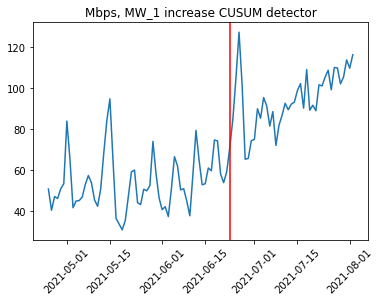

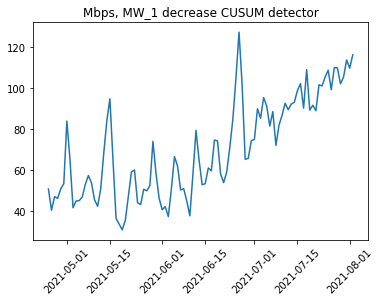

MW_10


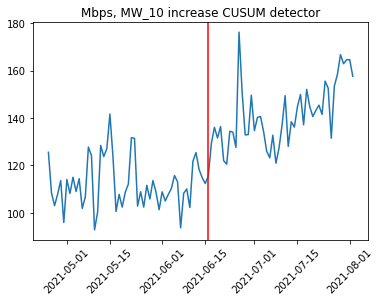

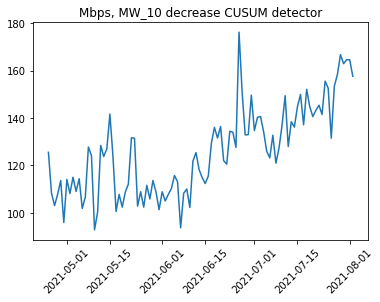

MW_11


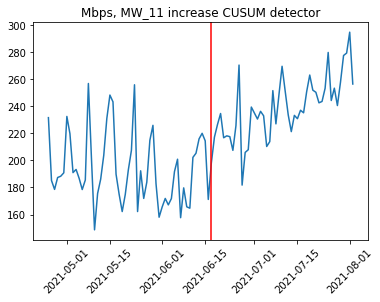

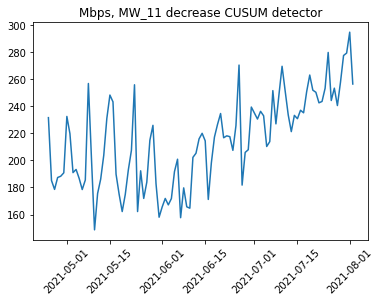

MW_12


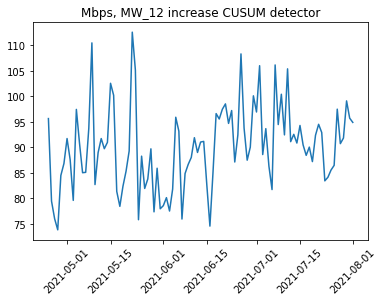

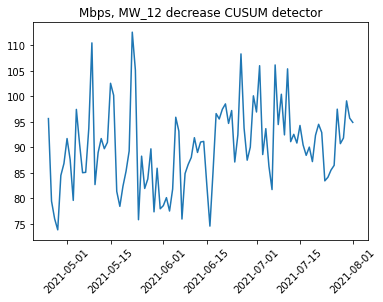

MW_13


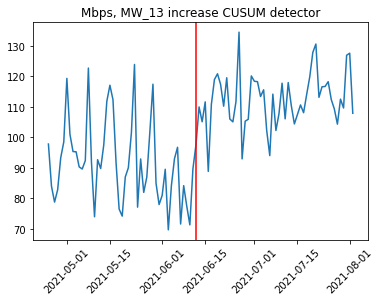

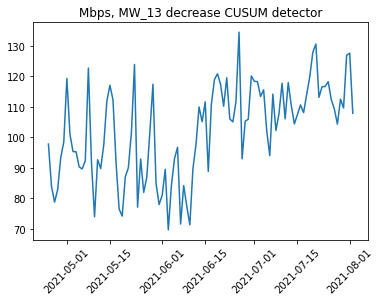

MW_14


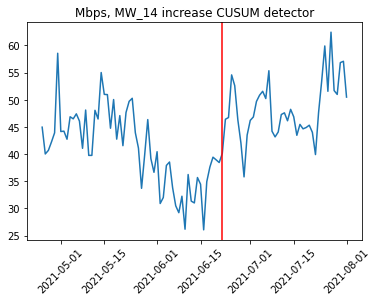

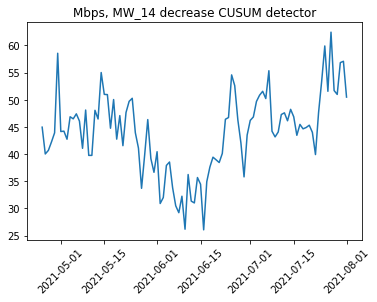

MW_15


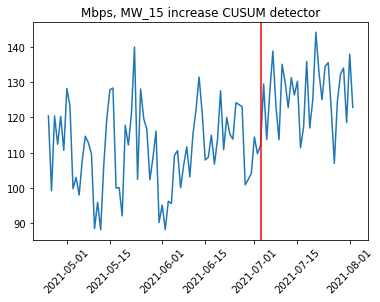

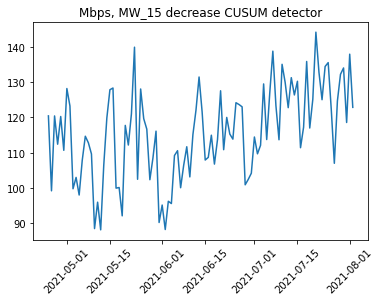

MW_16


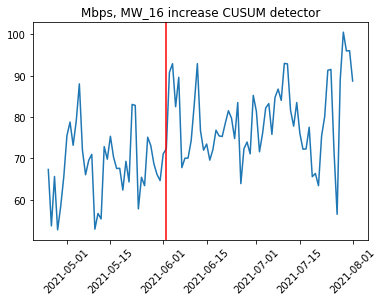

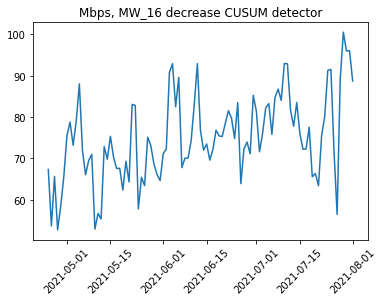

MW_17


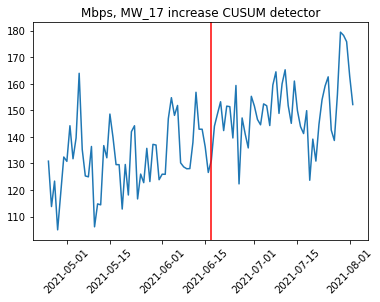

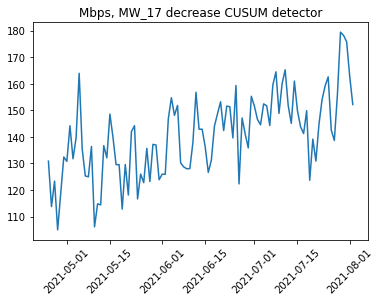

MW_18


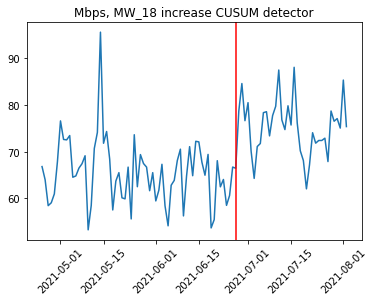

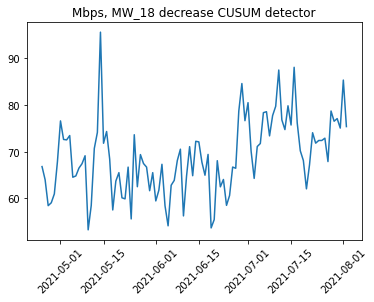

MW_19


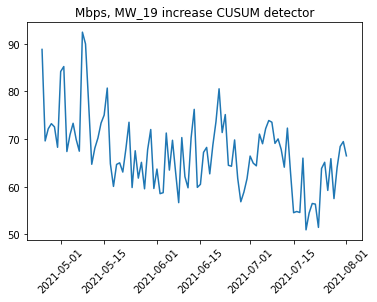

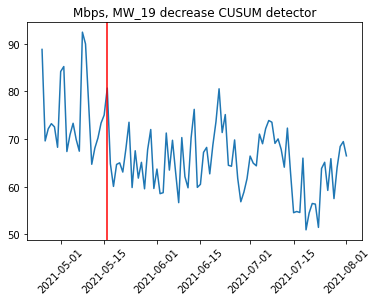

MW_2


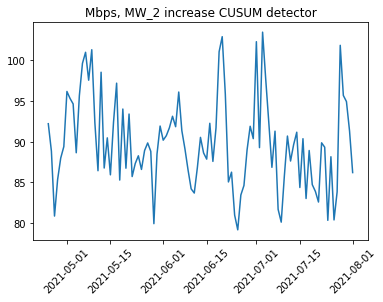

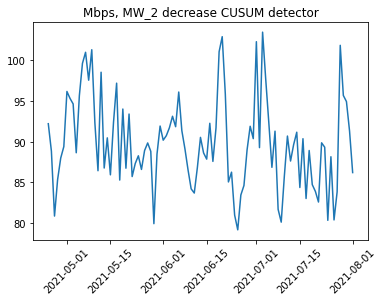

MW_20


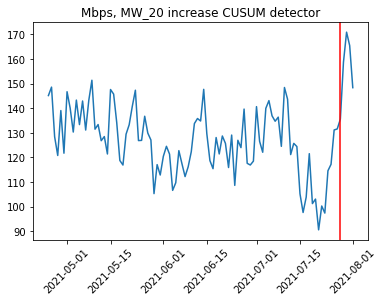

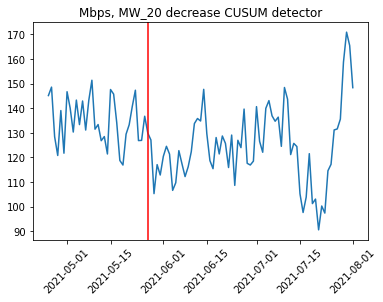

MW_21


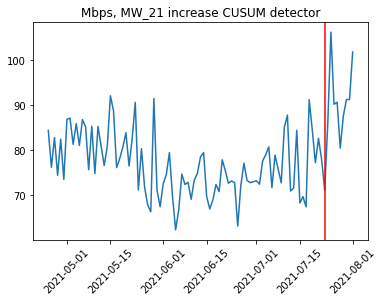

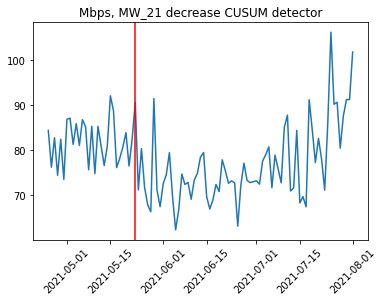

MW_22


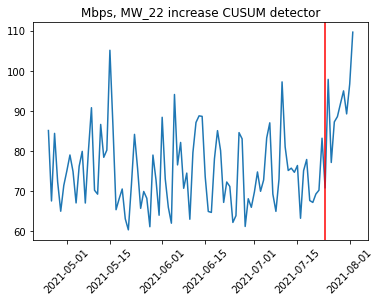

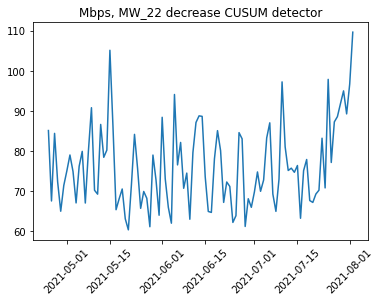

MW_3


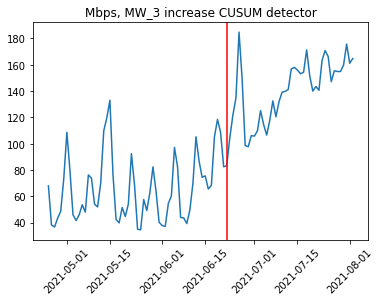

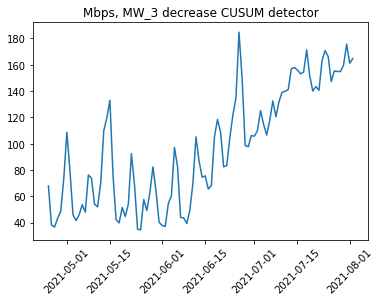

MW_4


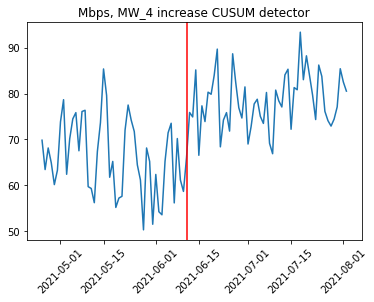

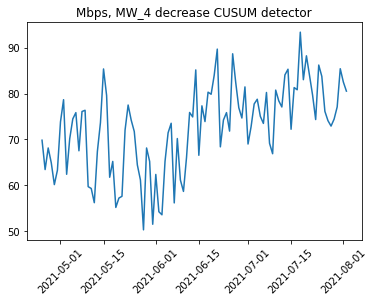

MW_5


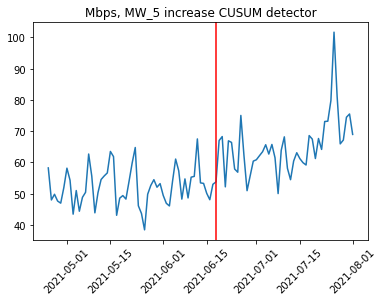

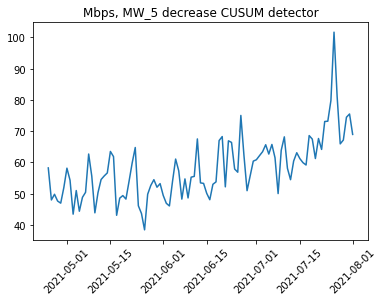

MW_6


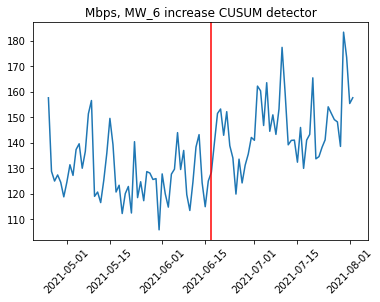

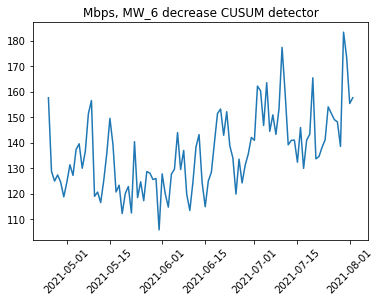

MW_7


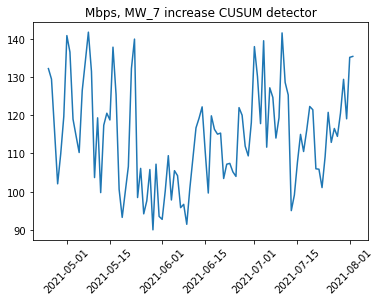

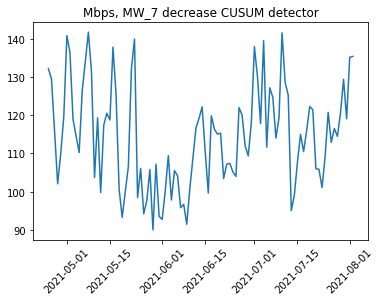

MW_8


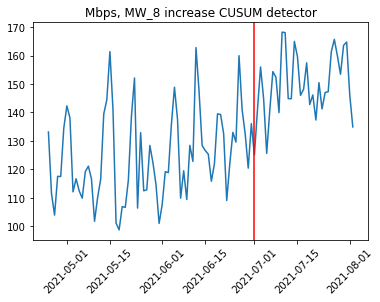

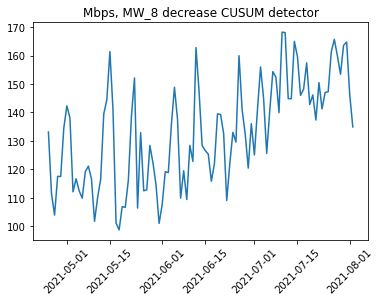

MW_9


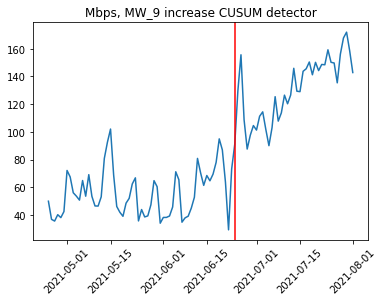

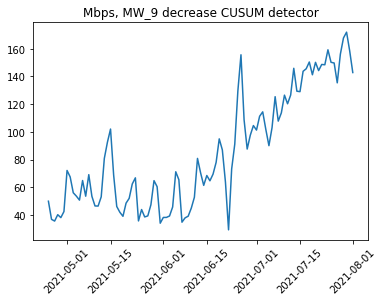

In [119]:
mws, _ = check_mw_db()

#mw = "MW_1"
for mw in mws:
    print(mw)
    
    node_type  = "mw"
    node_id    = mw
    n_days     = 100
    resolution = "day"

    column = "average_throughput" # Column from dataframe to find anomaly for

    cusum_detection_ts(node_type, node_id, n_days, resolution, column, agg_all_nodes=False)


## 2.2 Routers

Columns in database:  ['timestamp', 'router_id', 'port_speed', 'if', 'in_Mbps', 'out_Mbps']
First and last timestamp in db ['2021-02-04 08:45:00'] ['2021-08-03 08:15:00']
ROUTER_1


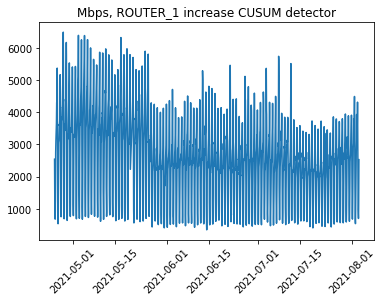

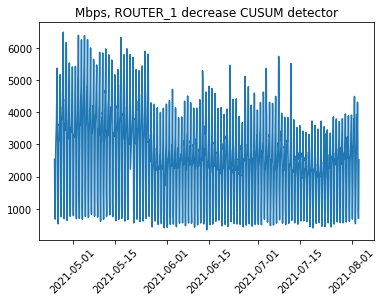

ROUTER_10


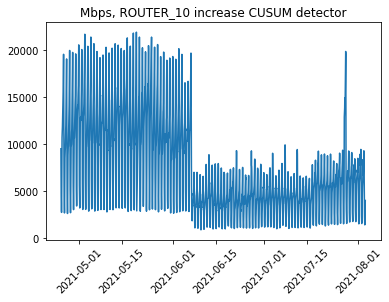

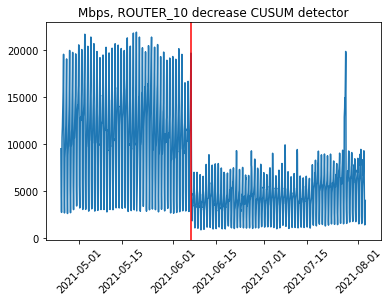

ROUTER_11


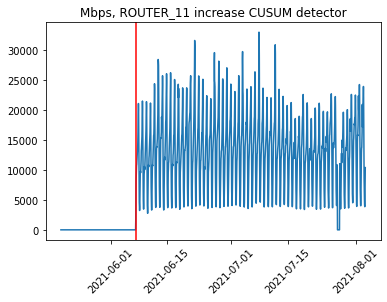

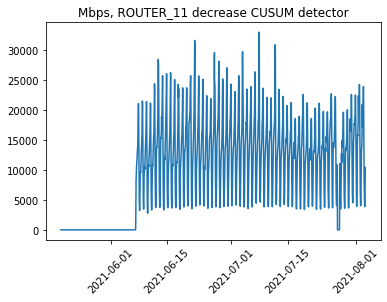

ROUTER_2


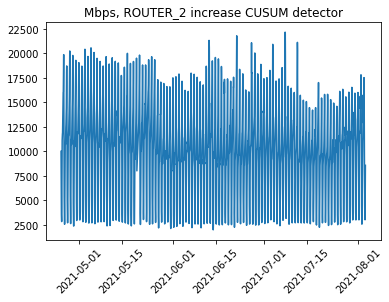

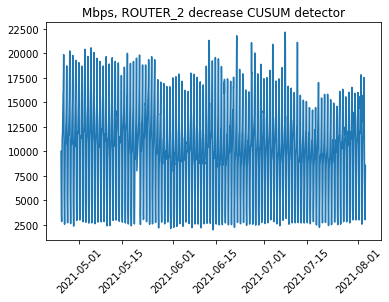

ROUTER_3


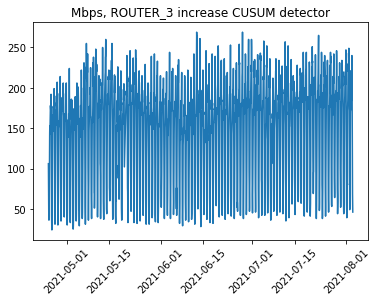

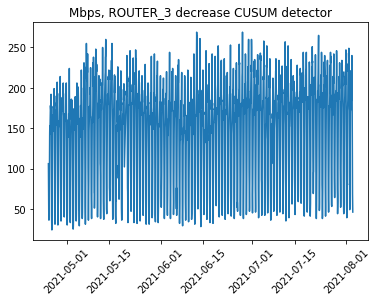

ROUTER_4


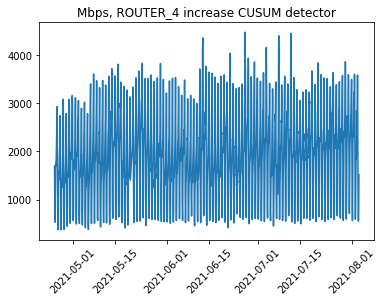

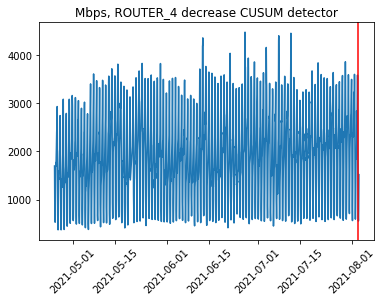

ROUTER_5


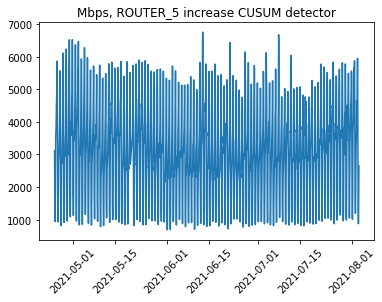

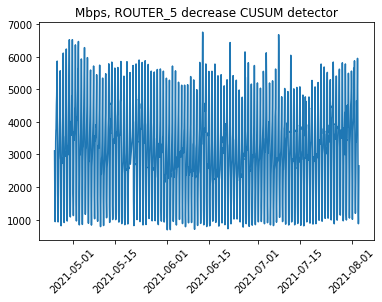

ROUTER_6


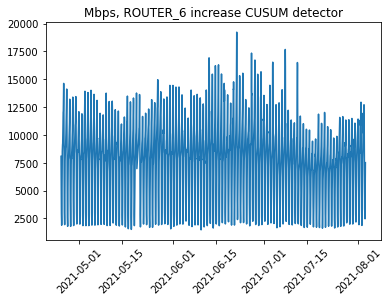

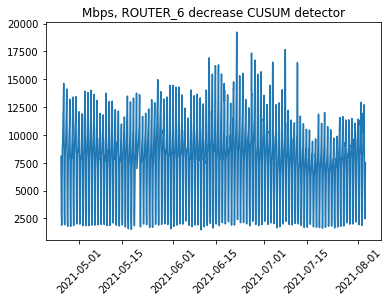

ROUTER_7


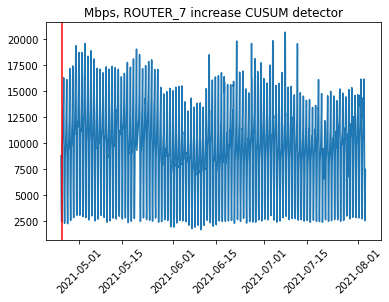

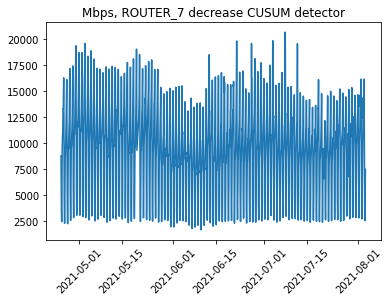

ROUTER_8


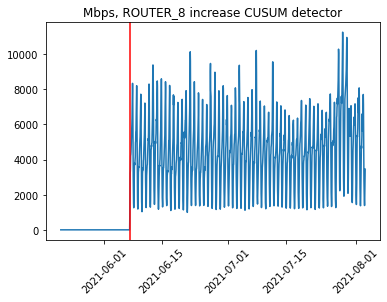

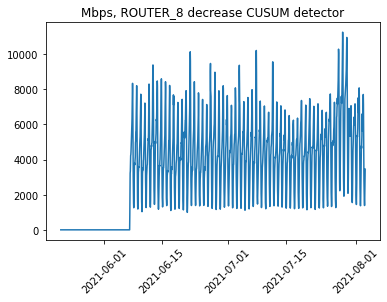

ROUTER_9


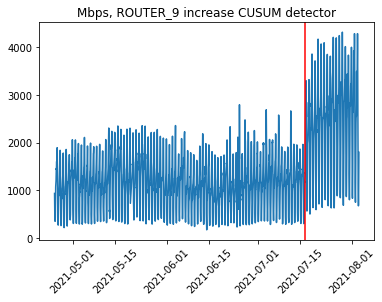

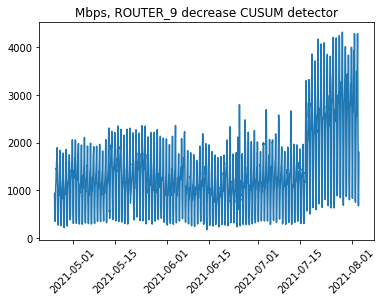

In [120]:
routers, _ = check_router_db()

#mw = "MW_1"
for router in routers:
    print(router)
    
    node_type  = "router"
    node_id    = router
    n_days     = 100
    resolution = "hour"
    column = "in_Mbps" # Column from dataframe to find anomaly for

    cusum_detection_ts(node_type, node_id, n_days, resolution, column, agg_all_nodes=False)

## 2.3 Plot a single MW node (or all nodes aggregated) with Plotly --> interactive plots

If you want to find change point for all nodes combined, set --> agg_all_nodes=True

In [159]:
node_type  = "mw"
node_id    = "MW_9"
n_days     = 200 # number of days we fetch data for
resolution = "day"
column = "average_throughput" # Column from dataframe to find anomaly for
end_time  = "2021-08-01"# for researh to tune what thresholds to use

cusum_detection_ts(node_type, node_id, n_days, resolution, column, end_time, agg_all_nodes=True, plotly_plot=True)


last timestamp:  2021-08-01


('Alert - Change point: ', Timestamp('2021-06-17 00:00:00'), '-')

### 2.4 Plot a single Router node with Plotly --> interactive plots

If you want to find change point for all routers combined, set --> agg_all_nodes=True

In [165]:
node_type  = "router"
node_id    = "ROUTER_10" # "ROUTER_9"
n_days     = 120 # number of days we fetch data for
resolution = "hour"
column = "in_Mbps" # Column from dataframe to find anomaly for
end_time  = "2021-06-18"# for researh to tune what thresholds to use

cusum_detection_ts(node_type, node_id, n_days, resolution, column, end_time, agg_all_nodes=False, plotly_plot=True)

last timestamp:  2021-06-18


('Alert - Change point: ', '-', Timestamp('2021-06-07 00:00:00'))

# 3 Anomaly detection with PyCaret library

### Unsupervised machine learning

With inspiration from:
https://towardsdatascience.com/time-series-anomaly-detection-with-pycaret-706a6e2b2427

read tuturial above to learn more about options with pycaret and anomaly detection via unsupervised machine learning

In [20]:
# init setup
from pycaret.anomaly import *

In [139]:
def ml_anomaly_detection(node_type, node_id, n_days, resolution, model, fraction, column, end_time, agg_all_nodes):
    """
    This function use machine learning by pycaret to return anomalies in time series data
    node_type = mw or router (str)
    node_id = node id (str)
    n_days = the number of daysback in time to run detection on (int)
    resolution = time frame, 15min hour or day (str)
    model = pycaret model, e.g. iforest, knn, cluster
    fraction = hyperparameter in model
    column = theThe column name of dataframe to run anomaly detection on (str)
    end_time = for research purpose. i.e. so we can set a specific time stamp datset ends (str)
    
    agg_all_nodes = if true, anomaly detection run on all links aggregated
    
    return plotly interactive plot, throughput vs anomalies
    """
    
    FRACTION = fraction # hyperparameter
    
    if node_type == "mw":
        df = get_mw_node(node_id, n_days, resolution, agg_all_nodes)
    elif node_type == "router":
        df = get_router_node(node_id, n_days, resolution, agg_all_nodes)
        
    # for research and tuning thresholds
    if end_time != "no": 
        print("last timestamp: ", end_time)
        df = df.loc[df["timestamp"] <= end_time]

    df.set_index('timestamp', inplace=True)
    
    # creature features from date
    df['day'] = [i.day for i in df.index]
    df['day_name'] = [i.day_name() for i in df.index]
    df['day_of_year'] = [i.dayofyear for i in df.index]
    df['week_of_year'] = [i.weekofyear for i in df.index]
    df['hour'] = [i.hour for i in df.index]
    df['is_weekday'] = [i.isoweekday() for i in df.index]
    
    # Setup pycaret
    # profiles the dataset and infers the data types for all input features
    s = setup(df, session_id = 123)

    # train model
    iforest = create_model(model, fraction = FRACTION) # fraction default 0.05
    iforest_results = assign_model(iforest)
    
    # Plot
    # plot value on y-axis and date on x-axis
    fig = px.line(iforest_results, x=iforest_results.index, y=column,
                  title=f"ML Anomaly detection, Node: {node_id if not agg_all_nodes else 'All nodes'}, Resolution: {resolution}",
                  template = 'plotly_white')
    # create list of outlier_dates
    outlier_dates = iforest_results[iforest_results['Anomaly'] == 1].index
    # obtain y value of anomalies to plot
    y_values = [iforest_results.loc[i][column] for i in outlier_dates]
    fig.add_trace(go.Scatter(x=outlier_dates, y=y_values, mode = 'markers', 
                    name = 'Anomaly', 
                    marker=dict(color='red',size=10)))
        
    fig.show()

    # return df sorted on anomaly, worst = first
    return iforest_results.sort_values("Anomaly_Score", ascending=False).head(3)



## 3.1 MW

In [140]:
# Select parameters and run function
node_type  = "mw"
node_id    = "MW_11"
n_days     = 360 # number of days we fetch data for
resolution = "day"
model      = "iforest" # the machine learning model to use
fraction   = 0.02
column     = "average_throughput" # column to run anomaly detection on
end_time   = "2021-04-25"# for researh to tune what thresholds to use

ml_anomaly_detection(node_type, node_id, n_days, resolution, model, fraction, column, end_time, agg_all_nodes=False)

INFO:logs:create_model_container: 1
INFO:logs:master_model_container: 1
INFO:logs:display_container: 2
INFO:logs:IForest(behaviour='new', bootstrap=False, contamination=0.02,
    max_features=1.0, max_samples='auto', n_estimators=100, n_jobs=-1,
    random_state=123, verbose=0)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:Initializing assign_model()
INFO:logs:assign_model(model=IForest(behaviour='new', bootstrap=False, contamination=0.02,
    max_features=1.0, max_samples='auto', n_estimators=100, n_jobs=-1,
    random_state=123, verbose=0), transformation=False, score=True, verbose=True)
INFO:logs:Checking exceptions
INFO:logs:Determining Trained Model
INFO:logs:Trained Model : Isolation Forest
INFO:logs:Copying data
INFO:logs:(236, 12)
INFO:logs:assign_model() succesfully completed......................................


,average_throughput,average_throughput_busy_hour,peak_throughput,node_id,day,day_name,day_of_year,week_of_year,hour,is_weekday,Anomaly,Anomaly_Score
timestamp,,,,,,,,,,,,
2021-04-19,165432408.0,165432408,318929000,MW_11,19,Monday,109,16,0,1,1,0.043331
2021-04-22,207479605.0,508482121,671446912,MW_11,22,Thursday,112,16,0,4,1,0.023402
2021-03-28,99621660.0,279438422,496771808,MW_11,28,Sunday,87,12,0,7,1,0.022161


## 3.2 Router

In [183]:
# Select parameters and run function
node_type  = "router"
node_id    = "ROUTER_10"
n_days     = 120 # number of days we fetch data for
resolution = "day"
model      = "iforest" # the machine learning model to use
fraction   = 0.005
column     = "in_Mbps" # column to run anomaly detection on
end_time  = "2021-06-09"# for researh to tune what thresholds to use

ml_anomaly_detection(node_type, node_id, n_days, resolution, model, fraction, column, end_time, agg_all_nodes=False)

INFO:logs:create_model_container: 1
INFO:logs:master_model_container: 1
INFO:logs:display_container: 2
INFO:logs:IForest(behaviour='new', bootstrap=False, contamination=0.005,
    max_features=1.0, max_samples='auto', n_estimators=100, n_jobs=-1,
    random_state=123, verbose=0)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:Initializing assign_model()
INFO:logs:assign_model(model=IForest(behaviour='new', bootstrap=False, contamination=0.005,
    max_features=1.0, max_samples='auto', n_estimators=100, n_jobs=-1,
    random_state=123, verbose=0), transformation=False, score=True, verbose=True)
INFO:logs:Checking exceptions
INFO:logs:Determining Trained Model
INFO:logs:Trained Model : Isolation Forest
INFO:logs:Copying data
INFO:logs:(66, 13)
INFO:logs:assign_model() succesfully completed......................................


,in_Mbps,out_Mbps,in_Mbps_max,out_Mbps_max,node_id,day,day_name,day_of_year,week_of_year,hour,is_weekday,Anomaly,Anomaly_Score
timestamp,,,,,,,,,,,,,
2021-06-08,3788.0,789.0,7102.0,1220.0,ROUTER_10,8,Tuesday,159,23,0,2,1,0.000237
2021-06-07,4368.0,777.0,10323.0,1184.0,ROUTER_10,7,Monday,158,23,0,1,0,-0.000491
2021-05-20,16125.0,1293.0,21583.0,1586.0,ROUTER_10,20,Thursday,140,20,0,4,0,-0.006840


In [38]:
# check list of available models
models()

INFO:logs:gpu_param set to False


,Name,Reference
ID,,
abod,Angle-base Outlier Detection,pyod.models.abod.ABOD
cluster,Clustering-Based Local Outlier,pyod.models.cblof.CBLOF
cof,Connectivity-Based Local Outlier,pyod.models.cof.COF
iforest,Isolation Forest,pyod.models.iforest.IForest
histogram,Histogram-based Outlier Detection,pyod.models.hbos.HBOS
knn,K-Nearest Neighbors Detector,pyod.models.knn.KNN
lof,Local Outlier Factor,pyod.models.lof.LOF
svm,One-class SVM detector,pyod.models.ocsvm.OCSVM
pca,Principal Component Analysis,pyod.models.pca.PCA


# 4. Anomaly Detection, Auto Correlation thresholds

A simple way to detect anomalies. We just compare current throughput to previous throughput.

Example, Consider traffic pattern 15min/ 1 hour data
- One hour back in time it should not differ to much.
- 14 hour back in tine it should differ a lot
- 24 hours back in time it should be very similar

Big deviations means something is wrong. Could be that traffic switched over to another path. For MW links it could be that it is running on low modulation. Or some errors that results in lower traffic.

In [152]:

def corr_anomaly_detection(node_type, node_id, n_days, resolution, column, corr_time ="no", plot=False, agg_all_nodes=False):
    
    """
    This function returns throughput anomalies, based  and auto correlation.
    
    node_type = 'router' or 'mw'
    node = the node to make forecast on (str)
    n_days = how many days back in time model should base forecast on (int)
    resolution = can be 'day', 'hour' (str)
    fcst_steps = steps to forecast (int) Based on what resolution choosed.
    corr_time = for research purpose. i.e. so we can set a specific time stamp to run correlations from (str)
    agg_all_nodes = if set to true, forcast done an all nodes in db aggregated (bool)
    
    --> Function returns auto correlation warnings
    
    """
    # Thresholds for autocorrelation - play arund with this :)
    THRESHOLD_1_HOUR = 0.9
    THRESHOLD_24_HOUR = 0.9
    THRESHOLD_168_HOUR = 0.9
    
    THRESHOLD_1_DAY = 0.7
    THRESHOLD_7_DAY = 0.7

    # call func to get data from sql db
    if node_type == "mw":
        df = get_mw_node(node_id, n_days, resolution, agg_all_nodes)
    elif node_type == "router":
        df = get_router_node(node_id, n_days, resolution, agg_all_nodes)

    # for research and tuning thresholds
    if corr_time != "no": 
        print("last timestamp: ", corr_time)
        df = df.loc[df["timestamp"] <= corr_time]

    if plot:
        # Plot with Plotly, create figure with secondary y-axis 
        fig = make_subplots(specs=[[{"secondary_y": True}]])
        # Add traces
        fig.add_trace(
                go.Scatter(x=df.timestamp, y=df[column], name=column),
                secondary_y=False,
            )
        # Add figure title
        fig.update_layout(
            title_text=f"Node id is: {node_id if not agg_all_nodes else 'All nodes'}, Resolution is: {resolution}"
        )
        # Set y-axes titles
        fig.update_yaxes(title_text="<b>** Throughput **</b>", secondary_y=False, color="black")
        fig.update_yaxes(title_text="<b>** xxx **</b>", secondary_y=True, color="purple")
        fig.show(renderer="notebook")

        
    if resolution == "hour":
        
        # Run autocorrelation
        autocorr_lag1 = df[column].autocorr(lag=1).round(2)
        autocorr_lag24 = df[column].autocorr(lag=24).round(2)
        autocorr_lag168 = df[column].autocorr(lag=168).round(2)
    
        lag_dict = {f"Lag 1_{resolution}": autocorr_lag1,
                    f"Lag 24_{resolution}": autocorr_lag24,
                    f"Lag 168_{resolution}": autocorr_lag168,
                   }

        if lag_dict[f'Lag 1_{resolution}'] < THRESHOLD_1_HOUR:
            print(f"WARNING {node_id}! 1 hour correlation is {lag_dict[f'Lag 1_{resolution}']}")
                  
        if lag_dict[f'Lag 24_{resolution}'] < THRESHOLD_24_HOUR:
            print(f"WARNING {node_id}! 24 hour correlation is {lag_dict[f'Lag 24_{resolution}']}")
            
        if lag_dict[f'Lag 168_{resolution}'] < THRESHOLD_24_HOUR:
            print(f"WARNING {node_id}! 1 week correlation is {lag_dict[f'Lag 168_{resolution}']}")
    
        # print(lag_dict)
    
    if resolution == "day":
        
        # Run autocorrelation
        autocorr_lag1 = df[column].autocorr(lag=1).round(2)
        autocorr_lag7 = df[column].autocorr(lag=7).round(2)
    
        lag_dict = {f"Lag 1_{resolution}": autocorr_lag1,
                    f"Lag 7_{resolution}": autocorr_lag7,
                   }

        if lag_dict[f'Lag 1_{resolution}'] < THRESHOLD_1_DAY:
            print(f"WARNING {node_id}! 1 day correlation is {lag_dict[f'Lag 1_{resolution}']}")
                  
        if lag_dict[f'Lag 7_{resolution}'] < THRESHOLD_7_DAY:
            print(f"WARNING {node_id}! 7 day correlation is {lag_dict[f'Lag 7_{resolution}']}")

        # print(lag_dict)
    
    return df.shape
    
    

## 4.1 MWs

In [153]:
node_type  = "mw"
node_id    = "MW_1"
n_days     = 300
resolution = "day"
column     = "average_throughput" # column name
corr_time  = "2021-08-25"# for researh to tune what thresholds to use

corr_anomaly_detection(node_type, node_id, n_days, resolution, column, corr_time=corr_time, plot=True, agg_all_nodes=False)
    
# Zoom in on graphs below (they are interactive)

last timestamp:  2021-08-25


(300, 5)

In [154]:
# Run this cell to make forecast on all nodes in db (takes a little time)

mws, _ = check_mw_db()

for mw in mws:
    print(mw)
    
    node_type  = "mw"
    node_id    = mw
    n_days     = 30
    resolution = "hour"
    column = "average_throughput" # column name
    corr_time  = pd.to_datetime("2021-08-02 21:00:00") # for researh to tune what thresholds to use
    
    corr_anomaly_detection(node_type, node_id, n_days, resolution, column, corr_time=corr_time, plot=False, agg_all_nodes=False)




Columns in database:  ['timestamp', 'node_id', 'average_throughput', 'peak_throughput']
First and last timestamp in db ['2020-09-02 15:15:00'] ['2021-08-03 00:00:00']
MW_1
last timestamp:  2021-08-02 21:00:00
WARNING MW_1! 1 hour correlation is 0.88
MW_10
last timestamp:  2021-08-02 21:00:00
MW_11
last timestamp:  2021-08-02 21:00:00
MW_12
last timestamp:  2021-08-02 21:00:00
WARNING MW_12! 1 hour correlation is 0.89
WARNING MW_12! 24 hour correlation is 0.89
WARNING MW_12! 1 week correlation is 0.87
MW_13
last timestamp:  2021-08-02 21:00:00
WARNING MW_13! 1 hour correlation is 0.89
WARNING MW_13! 24 hour correlation is 0.85
WARNING MW_13! 1 week correlation is 0.85
MW_14
last timestamp:  2021-08-02 21:00:00
WARNING MW_14! 1 hour correlation is 0.88
WARNING MW_14! 24 hour correlation is 0.85
WARNING MW_14! 1 week correlation is 0.8
MW_15
last timestamp:  2021-08-02 21:00:00
WARNING MW_15! 1 hour correlation is 0.89
WARNING MW_15! 24 hour correlation is 0.87
MW_16
last timestamp:  2021

## 4.1 Routers

In [185]:
node_type  = "router"
node_id    = "ROUTER_4"
n_days     = 200
resolution = "day"
column     = "in_Mbps" # column name
corr_time  = "2021-04-14"# for researh to tune what thresholds to use

corr_anomaly_detection(node_type, node_id, n_days, resolution, column, corr_time=corr_time, plot=True, agg_all_nodes=False)
    
# Zoom in on graphs below (they are interactive)

last timestamp:  2021-04-14


WARNING ROUTER_4! 1 day correlation is 0.55
WARNING ROUTER_4! 7 day correlation is 0.2


(70, 6)

In [157]:
# Run this cell to make forecast on all nodes in db (takes a little time)

routers, _ = check_router_db()

for router in routers:
    
    node_type  = "router"
    node_id    = router
    n_days     = 100
    resolution = "day"
    column     = "in_Mbps" # column name
    corr_time  = "2021-08-01"# for researh to tune what thresholds to use

    corr_anomaly_detection(node_type, node_id, n_days, resolution, column, corr_time=corr_time, plot=False, agg_all_nodes=False)

# Zoom in on graphs below (they are interactive)
    

Columns in database:  ['timestamp', 'router_id', 'port_speed', 'if', 'in_Mbps', 'out_Mbps']
First and last timestamp in db ['2021-02-04 08:45:00'] ['2021-08-03 08:15:00']
last timestamp:  2021-08-01
last timestamp:  2021-08-01
last timestamp:  2021-08-01
last timestamp:  2021-08-01
WARNING ROUTER_2! 1 day correlation is 0.57
WARNING ROUTER_2! 7 day correlation is 0.38
last timestamp:  2021-08-01
WARNING ROUTER_3! 1 day correlation is 0.53
WARNING ROUTER_3! 7 day correlation is 0.27
last timestamp:  2021-08-01
WARNING ROUTER_4! 1 day correlation is 0.55
WARNING ROUTER_4! 7 day correlation is 0.55
last timestamp:  2021-08-01
WARNING ROUTER_5! 1 day correlation is 0.51
WARNING ROUTER_5! 7 day correlation is 0.41
last timestamp:  2021-08-01
WARNING ROUTER_6! 1 day correlation is 0.61
WARNING ROUTER_6! 7 day correlation is 0.51
last timestamp:  2021-08-01
WARNING ROUTER_7! 1 day correlation is 0.65
WARNING ROUTER_7! 7 day correlation is 0.38
last timestamp:  2021-08-01
WARNING ROUTER_8! 7 d